In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.metrics import mean_squared_error, accuracy_score, r2_score
from sklearn.feature_selection import RFE
from sklearn.linear_model import LassoCV
from sklearn.svm import SVR
from sklearn import ensemble
from sklearn.utils import shuffle

%matplotlib inline

In [2]:
train = pd.read_csv('projeto8-training.csv')
test = pd.read_csv('projeto8-testing.csv')

# Análise Exploratória dos Dados

## O que representa cada variável?


- **date:** Tempo de coleta dos dados pelos sensores
- **Appliances:** Uso de energia (em W)
- **lights:** Potência de energia de eletrodomésticos na casa (em W)
- **TX:** Temperatura em um lugar da casa (em Celsius)
- **RH_X:** Umidade relativa em algum ponto da casa (em %)
- **Windspeed:** Velocidade do vento (em m/s)
- **Visibility:** Visibilidade (em Km)
- **Tdewpoint:** Não foi informado.
- **rv1:** Variável randômica adicional
- **rv2:** Variável randômica adicional
- **WeekStatus:** Indica se é dia de semana ou final de semana
- **Day_of_week:** Dia da semana
- **NSM:** Medida de tempo (em s)

In [3]:
# Printando informações do dataset.
print(f'O dataset de treino possui {train.shape[0]} linhas e {train.shape[1]} variáveis')
print(f'O dataset de teste possui {test.shape[0]} linhas e {test.shape[1]} variáveis')
print(f'Nome das variáveis de treino: {list(train.columns)}')
print(f'Nome das variáveis de teste: {list(test.columns)}')

O dataset de treino possui 14803 linhas e 32 variáveis
O dataset de teste possui 4932 linhas e 32 variáveis
Nome das variáveis de treino: ['date', 'Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility', 'Tdewpoint', 'rv1', 'rv2', 'NSM', 'WeekStatus', 'Day_of_week']
Nome das variáveis de teste: ['date', 'Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility', 'Tdewpoint', 'rv1', 'rv2', 'NSM', 'WeekStatus', 'Day_of_week']


Já que nossos dados possuem a mesma quantidade de colunas e elas são iguais, irei fazer um merge dos dados de treino e teste e analisá-los juntos.

In [4]:
df = pd.concat([train, test], axis=0)

In [5]:
print(f'O novo dataset possui {df.shape[0]} linhas e {df.shape[1]} variáveis')
print(f'O dataset possui {sum(df.isnull().sum())} valores nulos')

O novo dataset possui 19735 linhas e 32 variáveis
O dataset possui 0 valores nulos


Não será preciso realizar nenhum tratamento de valores missing.

In [6]:
df.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,NSM
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,...,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,...,41.552401,7.411665,755.522602,79.750418,4.039752,38.330834,3.760707,24.988033,24.988033,42907.129465
std,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,...,4.151497,5.317409,7.399441,14.901088,2.451221,11.794719,4.194648,14.496634,14.496634,24940.020831
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,...,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322,0.000000
25%,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,...,38.500000,3.666667,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889,21600.000000
50%,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,...,40.900000,6.916667,756.100000,83.666667,3.666667,40.000000,3.433333,24.897653,24.897653,43200.000000
75%,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,...,44.338095,10.408333,760.933333,91.666667,5.500000,40.000000,6.566667,37.583769,37.583769,64200.000000
max,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,...,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530,85800.000000


Vamos separar variáveis numéricas e categóricas para melhor observar algumas informações

In [7]:
num_vars = [name for name in df.columns if df[name].dtype != 'object']
cat_vars = [name for name in df.columns if df[name].dtype == 'object']
df_num = df[num_vars]
df_cat = df[cat_vars]
print(f'O data set possui {len(num_vars)} variáveis numéricas e {len(cat_vars)} de tipo objeto, sendo todas relacionadas à data')

O data set possui 29 variáveis numéricas e 3 de tipo objeto, sendo todas relacionadas à data


In [8]:
# converter a coluna 'date' para tipo data
df_cat['date'] = pd.to_datetime(df_cat['date'])

/home/luciano/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [9]:
df_cat.dtypes

date           datetime64[ns]
WeekStatus             object
Day_of_week            object
dtype: object

In [10]:
# Transformando a coluna de data em index podemos realizar algumas análises
# de forma mais simples.
df_cat.index = pd.DatetimeIndex(df_cat['date'])
df_num.index = pd.DatetimeIndex(df_cat['date'])

In [11]:
# Também precisaremos de uma coluna com as datas (utilizada para alguns plots).
df_num['date'] = df_cat['date'].copy()

/home/luciano/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [12]:
df_num.columns

Index(['Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4',
       'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9',
       'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility',
       'Tdewpoint', 'rv1', 'rv2', 'NSM', 'date'],
      dtype='object')

In [13]:
df_cat.columns

Index(['date', 'WeekStatus', 'Day_of_week'], dtype='object')

## Pairplot

O código abaixo permite a visualização de um pairplot filtrado por períodos. È possível visualizar os dados em diferentes intervalos de dias, semanas, meses e ano (caso nosso dataset tivesse dados de um ano diferente à 2016).

2016-05 até 2016-05-01 23:00:00 com 3853 pontos


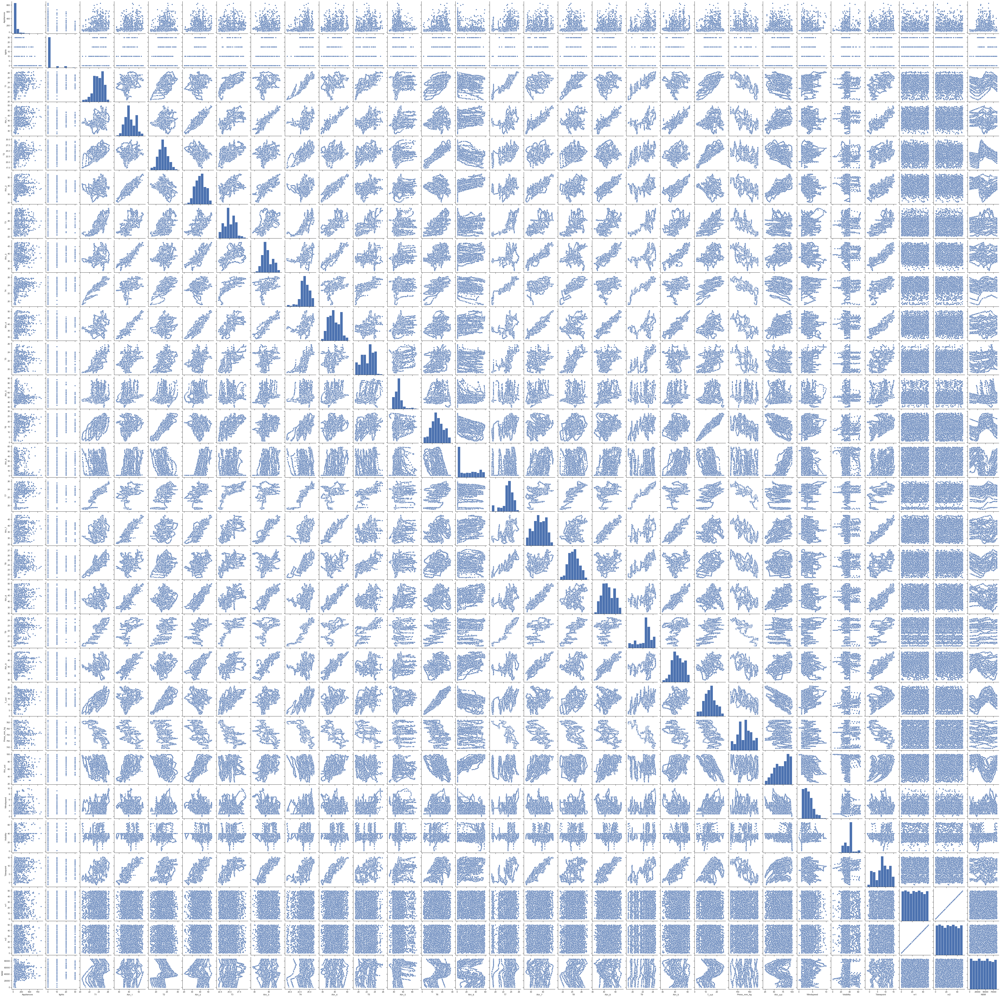

In [14]:
# Precisa editar algumas linhas caso precise plotar um dia específico
# ou intervalo específico.
year_start = '2016'
month_start = '05'
day = int('01')
# fim
year_end = '2016'
month_end = '05'

if day < 10:
    # date_start = year_start + '-' + month_start + '-' + '0' + str(day_range) + ' 00:00:00'
    date_start = year_start + '-' + month_start
    date_end = year_end + '-' + month_end + '-' + '0' + str(day) + ' 23:00:00'
else:
    # date_start = year_start + '-' + month_start + '-' + str(day_range) + ' 00:00:00'
    date_start = year_start + '-' + month_start
    date_end = year_end + '-' + month_end + '-' + str(day) + ' 23:00:00'

print(f'{date_start} até {date_end} com {len(df_num[date_start])} pontos')

sns.set(style="ticks", color_codes=True)
df_filter = df_num[date_start] # date_start:date_end
g = sns.pairplot(df_filter)
plt.show()

Podemos visualizar que a maioria das distribuição se assemelham à uma distribuição normal, sendo que algumas poucas possuem desvios. Vamos verificar agora se existe a presença de muitos outliers nos dados

## Boxplot

2016-04 até 2016-05-01 23:00:00 com 4320 pontos


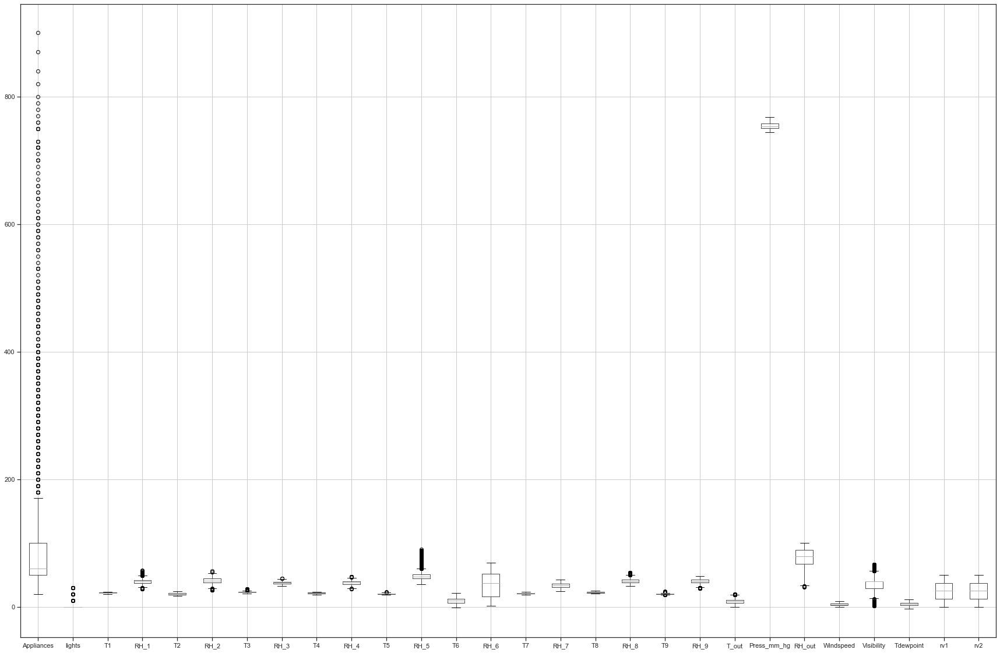

In [15]:
# Novamente, cada plot tem um código que permite o filtro por data.
year_start = '2016'
month_start = '04'
day = int('01')
# fim
year_end = '2016'
month_end = '05'

if day < 10:
    date_start = year_start + '-' + month_start
    date_end = year_end + '-' + month_end + '-' + '0' + str(day) + ' 23:00:00'
else:
    date_start = year_start + '-' + month_start
    date_end = year_end + '-' + month_end + '-' + str(day) + ' 23:00:00'

print(f'{date_start} até {date_end} com {len(df_num[date_start])} pontos')

plt.subplots(figsize=(30, 20))
sns.set(style="ticks", color_codes=True)
df_filter = df_num[date_start]
df_filter = df_filter.drop(['date', 'NSM'], axis=1)
df_filter.boxplot()
plt.show()

Os dados que mais possuem outliers é a variável target. Será tratado mais a frente.

## Plot Comparativo

2016-04-01 00:00:00 até 2016-04-01 23:00:00 com 139 pontos
2016-04-02 00:00:00 até 2016-04-02 23:00:00 com 139 pontos
2016-04-03 00:00:00 até 2016-04-03 23:00:00 com 139 pontos
2016-04-04 00:00:00 até 2016-04-04 23:00:00 com 139 pontos
2016-04-05 00:00:00 até 2016-04-05 23:00:00 com 139 pontos
2016-04-06 00:00:00 até 2016-04-06 23:00:00 com 139 pontos
2016-04-07 00:00:00 até 2016-04-07 23:00:00 com 139 pontos
2016-04-08 00:00:00 até 2016-04-08 23:00:00 com 139 pontos
2016-04-09 00:00:00 até 2016-04-09 23:00:00 com 139 pontos
2016-04-10 00:00:00 até 2016-04-10 23:00:00 com 139 pontos


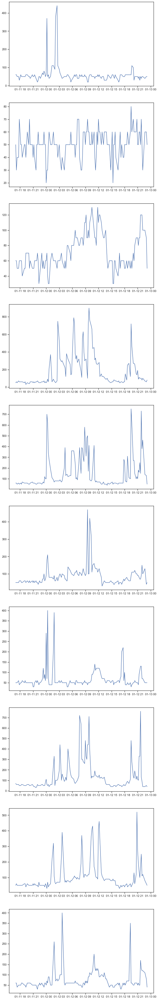

In [16]:
# Gráficos comparativo de qualquer variável ao longo de um período
# Determine o período de início e fim que deseja visualizar 
# E determine a variável name com a variável a ser observada
# início
year_start = '2016'
month_start = '04'
day = '01'
# fim
year_end = '2016'
month_end = '04'

# plot automatizado
# n = número de subplots (dias para visualizar)
n = 10
name = 'Appliances'
fig, ax = plt.subplots(n, figsize=(10, 70))
for i in range(0, n):
    day_range = int(day) + i
    if day_range < 10:
        date_start = year_start + '-' + month_start + '-' + '0' + str(day_range) + ' 00:00:00'
        date_end = year_end + '-' + month_end + '-' + '0' + str(day_range) + ' 23:00:00'
    else:
        date_start = year_start + '-' + month_start + '-' + str(day_range) + ' 00:00:00'
        date_end = year_end + '-' + month_end + '-' + str(day_range) + ' 23:00:00'
    dates, values = zip(*sorted(zip(df_num['date'],df_num[date_start: date_end][name])))
    ax[i].plot_date(dates,values, '-')
    print(f'{date_start} até {date_end} com {len(df_num[date_start: date_end][name])} pontos')

Com o código acima é possível visualizar o comportamento de qualquer variável numérica em relação ao tempo. Podemos concluir algumas observações:

- **temperatura interna:** Possui valores de 20 a 25, acredito que graus Celsius, tendo picos durante a noite. Período em que provavelmente o aquecedor está ligado.
- **temperatura externa:** Possui valores baixos, categorizando um país frio que é a Bélgica. Também apresenta variação de acordo o por e nascer do sol
- **RH e RH_out:** Apresenta uma variabilidade interessante para explicar o comportament do Appliances.
- **Pressão:** Apresenta um comportamento bem padrão.
- **rv_1, rv_2:** Possuem um comportamento bem aleatório ao longo do tempo, já que se trata realmente de uma variável aleatória adicionada aos dados.


## FacetGrid

Este é um tipo de gráfico que permite a visualização do comportamento de mais de duas variáveis ao mesmo tempo.

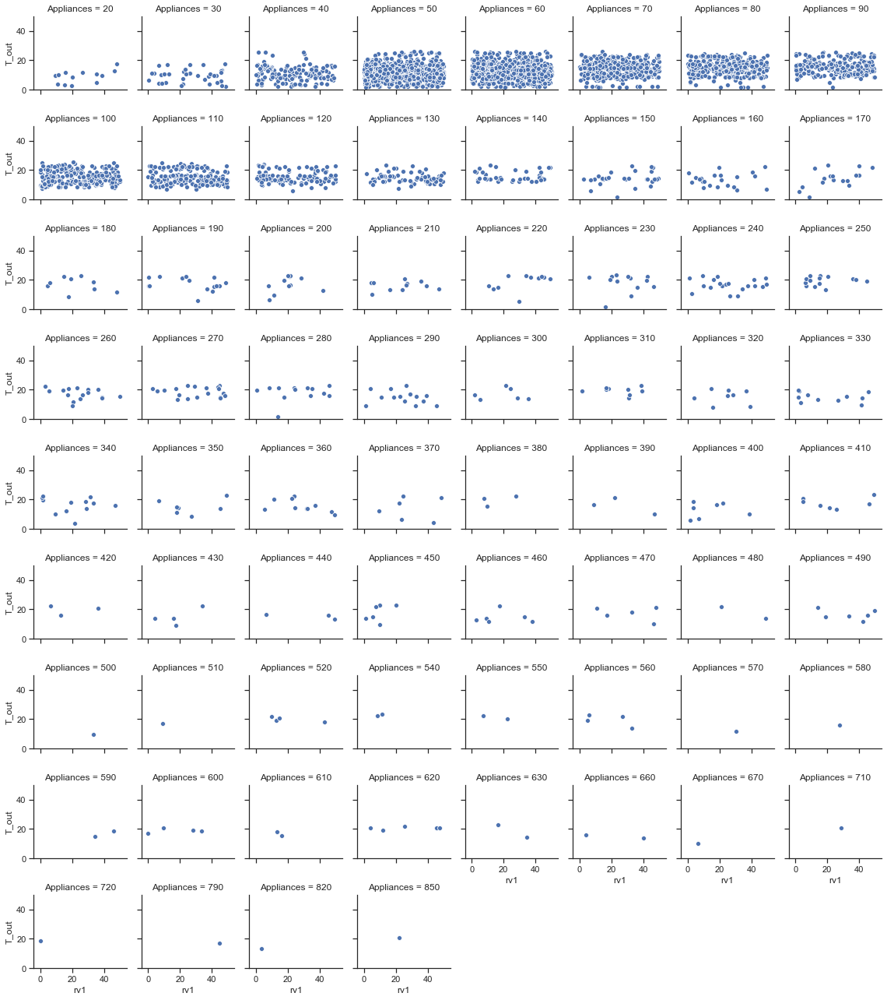

In [17]:
# Aqui basta alterar o intervalo desejado e as variáveis desejadas
g = sns.FacetGrid(df_num['2016-05'], col="Appliances", col_wrap=8, height=2, ylim=(0, 50))
g.map(sns.scatterplot, "rv1", "T_out", ci=None);

Vemos que a maior varialibilidade dos dados se dá entre 20 a 130 do Appliance. Logo a modelagem pode ser favorecida a partir da remoção de outliers.

# Feature Engineering

## Tratamento de outliers

Como vimos que o 'Appliances' possui muito valores outliers. Podemo iniciar o tratamento pela elimação desses valores

In [18]:
# Primeiro e terceiro quartil e cálculo da distância IQR
Q1 = df_num['Appliances'].quantile(0.25)
Q3 = df_num['Appliances'].quantile(0.75)
IQR = Q3 - Q1
print(Q1)
print(Q3)
print(IQR)

50.0
100.0
50.0


In [19]:
# Determinação dos ranges inferiores e superiores do boxplot
Lower_Whisker = Q1 - 1.5*IQR
Upper_Whisker = Q3 + 1.5*IQR
print(Lower_Whisker, Upper_Whisker)

-25.0 175.0


In [20]:
# Remoção dos dados outiliers
new_df = df_num[df_num['Appliances'] < 175.0]

2016-04 até 2016-05-01 23:00:00 com 3870 pontos


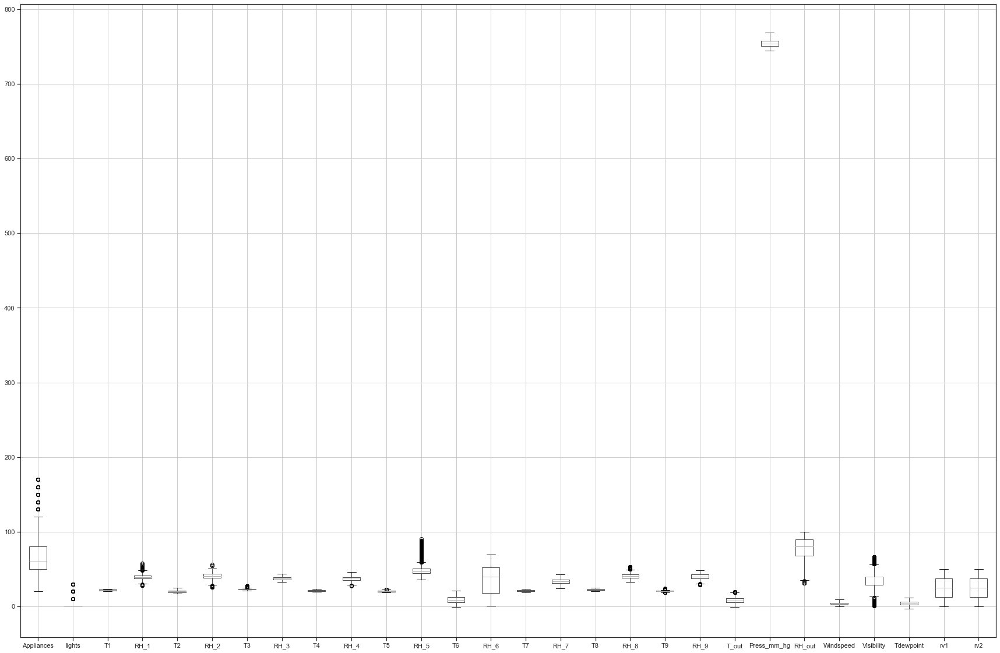

In [21]:
year_start = '2016'
month_start = '04'
day = int('01')
# fim
year_end = '2016'
month_end = '05'

if day < 10:
    date_start = year_start + '-' + month_start
    date_end = year_end + '-' + month_end + '-' + '0' + str(day) + ' 23:00:00'
else:
    date_start = year_start + '-' + month_start
    date_end = year_end + '-' + month_end + '-' + str(day) + ' 23:00:00'

print(f'{date_start} até {date_end} com {len(new_df[date_start])} pontos')

plt.subplots(figsize=(30, 20))
sns.set(style="ticks", color_codes=True)
df_filter = new_df[date_start]
df_filter = df_filter.drop(['date', 'NSM'], axis=1)
df_filter.boxplot()
plt.show()

In [22]:
# Removendo variável de data, adicionada para ajudar na construção dos gráficos
new_df_num = new_df.drop(['date'], axis=1)

In [23]:
# Resetando o index
new_df_num.reset_index(drop=True, inplace=True)
new_df_num.index

RangeIndex(start=0, stop=17597, step=1)

## Correlation

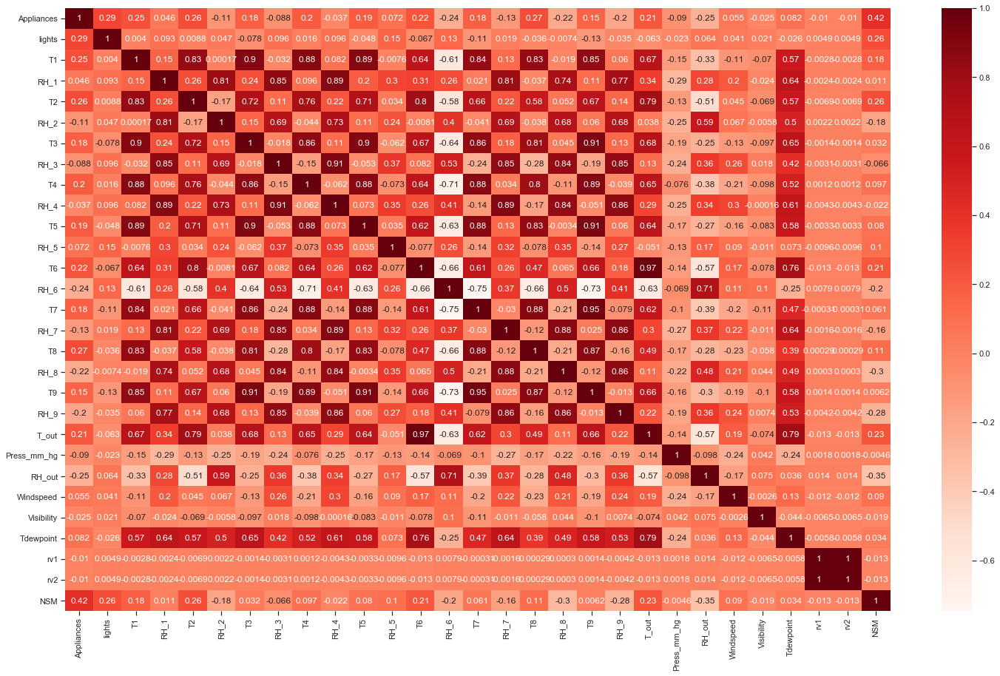

In [24]:
# Using Pearson Correlation
# General correlation
plt.figure(figsize=(25,15))
cor = new_df_num.corr()
sns.heatmap(cor, annot=True, cmap=plt.cm.Reds)
plt.show()

In [25]:
#Correlation with output variable
cor_target = abs(cor["Appliances"])
#Selecting highly correlated features
relevant_features = cor_target[cor_target<0.2]
relevant_features

RH_1           0.045596
RH_2           0.109746
T3             0.180061
RH_3           0.088410
T4             0.195689
RH_4           0.036932
T5             0.191782
RH_5           0.072040
T7             0.175519
RH_7           0.128740
T9             0.154471
Press_mm_hg    0.089829
Windspeed      0.055363
Visibility     0.024974
Tdewpoint      0.081550
rv1            0.009986
rv2            0.009986
Name: Appliances, dtype: float64

Observação interessante é que maioria das variáveis possuem uma correlação negativa, ou seja, o 'Appliances' diminui a medida que determinada variável diminui.

## Normalização

In [35]:
# lembrando que a variável target não tem necessidade de ser normalizada
new_df_num_Y = new_df_num['Appliances']
new_df_num = new_df_num.drop(['Appliances'], axis=1)
# normalização
min_max_scaler = MinMaxScaler()
columns = list(new_df_num.columns)
print(columns)
for name in columns:
    # convertemos para np array pois é a forma que o min_max_scaler
    # recebe os dados
    new_df_num[name] = min_max_scaler.fit_transform(np.array(new_df_num[name]).reshape(-1, 1))

['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility', 'Tdewpoint', 'rv1', 'rv2', 'NSM']


Algumas variáveis ainda possuem muitos outliers, mas serão mantidas.

# Feature Selection

Vamos aplicar 2 diferentes métodos de seleção de variáveis e assim decidir qual será o próximo passo.

## Recursive Elimination

Neste método, precisamos definir quantas variáveis queremos para rodar o modelo, e depois, quando obtido o número ótimo aplicamos a seleção de variáveis. O método identifica, recursivamente, qual conjunto de variáveis possuem maior score.

In [38]:
new_df_num.shape

(17597, 28)

In [39]:
#no of features
nof_list=np.arange(1,28)            
high_score=0
#Variable to store the optimum features
nof=0           
score_list =[]
for n in range(len(nof_list)):
    X_train, X_test, y_train, y_test = train_test_split(new_df_num, new_df_num_Y, test_size = 0.3, random_state = 0)
    model = LinearRegression()
    rfe = RFE(model,nof_list[n])
    X_train_rfe = rfe.fit_transform(X_train,y_train)
    X_test_rfe = rfe.transform(X_test)
    model.fit(X_train_rfe,y_train)
    score = model.score(X_test_rfe,y_test)
    score_list.append(score)
    if(score>high_score):
        high_score = score
        nof = nof_list[n]
print("Optimum number of features: %d" %nof)
print("Score with %d features: %f" % (nof, high_score))

Optimum number of features: 21
Score with 21 features: 0.353213


In [40]:
cols = list(new_df_num.columns)
model = LinearRegression()
#Initializing RFE model
rfe = RFE(model, 21)
#Transforming data using RFE
X_train, X_test, y_train, y_test = train_test_split(new_df_num, new_df_num_Y, test_size = 0.3, random_state = 0)
X_rfe = rfe.fit_transform(X_train,y_train)  
#Fitting the data to model
model.fit(X_rfe,y_train)             
temp = pd.Series(rfe.support_,index = cols)
selected_features_rfe = temp[temp==True].index
print(selected_features_rfe)

Index(['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4', 'T5',
       'RH_5', 'T6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9', 'RH_9', 'T_out',
       'Windspeed', 'NSM'],
      dtype='object')


## Embedded Method

Best alpha using built-in LassoCV: 0.003504
Best score using built-in LassoCV: 0.356319


Text(0.5, 1.0, 'Feature importance using Lasso Model')

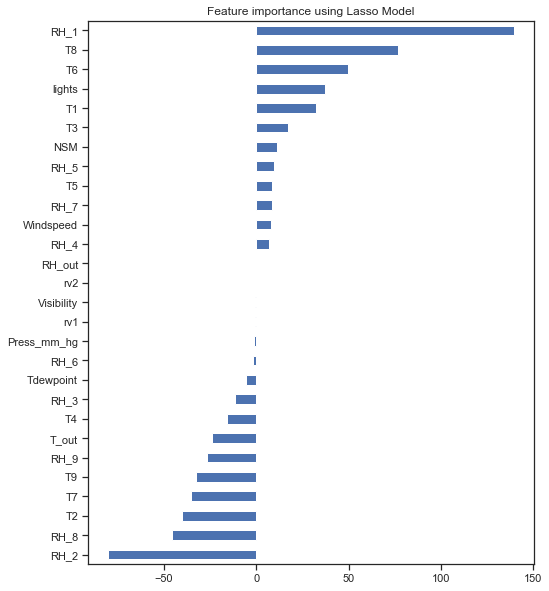

In [41]:
reg = LassoCV()
reg.fit(X_train, y_train)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X_train,y_train))
coef = pd.Series(reg.coef_, index = new_df_num.columns)

imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (8.0, 10.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

# Machine Learning

In [57]:
# removendo variáveis aletórias antes de aplicar o modelo
new_df_v = new_df_num.drop(['rv1', 'rv2'], axis=1)

In [58]:
X_train, X_test, y_train, y_test = train_test_split(new_df_v, new_df_num_Y, train_size=0.7)

In [59]:
# Regressão Linear Múltipla
modelo = LinearRegression()
modelo.fit(X_train, y_train)
y_pred = modelo.predict(X_test)

score =  r2_score(y_test, y_pred)
print(score)

0.34058856776814994


In [60]:
# Support Vector Regression
modelo = SVR()
modelo.fit(X_train, y_train)
y_pred = modelo.predict(X_test)

score =  r2_score(y_test, y_pred)
print(score)

0.3594652532873541


In [61]:
# Gradient Boosting Regressor
params = {'n_estimators': 500, 'max_depth': 8, 'min_samples_split': 2,
          'learning_rate': 0.01, 'loss': 'ls'}
clf = ensemble.GradientBoostingRegressor(**params)

clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
r2score = r2_score(y_test, y_pred)
print(f"R2 SCORE: {r2score}")


R2 SCORE: 0.6598527787973895


Vemos então que o modelo que apresentou melhor resultado foi o Gradient Boosting Regressor, com 65,98% na métrica de R$^{2}$.